In [1]:
import networkx as nx
import matplotlib.pyplot as plt
import json
import numpy as np
import math
import heapq
import PIL
import requests

from io import BytesIO
from networkx.algorithms import bipartite
from fa2 import ForceAtlas2
from urllib import error, request
from numba import jit
from nltk import word_tokenize
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from io import BytesIO
from statistics import mean,stdev
from IPython.display import Image
from networkx.readwrite import json_graph

In [2]:
simsons_api_base_url = "https://simpsons.wikia.com/api/v1"

In [3]:
def api_call(params, limit=100, section="Articles", action="List", clean=False):
    url = f"{simsons_api_base_url}/{section}/{action}?{limit}&{params if params else ''}" if not clean else f"{simsons_api_base_url}/{section}/{params}"
    req = request.Request(url)
    try:
        res = request.urlopen(req).read()
        return json.loads(res.decode("utf-8"))
    except error.HTTPError as err:
        print(err)

In [4]:
def get_season_dictionary():
    seasons = {}
    for i in range(1,31):
        episodes = []
        json_response = api_call(f'category=Season_{i}_episodes')
        for episode in json_response['items']:
            episodes.append(episode['title'])
        seasons[i] = episodes
    return seasons

# Welcome to the Simpsons Universe!
## In this notebook we're going to introduce our project for the Social Graphs and Interaction course. Come along!

Our project started with downloading, cleaning and scraping data from the Simpsons Wikia (http://simpsons.wikia.com/wiki/Simpsons_Wiki). There is an API provided for this Wikia (http://simpsons.wikia.com/api/v1) but unfortunately we were not always able to the data from that since it has its own limitations. In that cases we had to scrape raw HTML which we had to process and clean afterwards.

We created two networks: 
* One based on the **links** refering from one character page to another
    * Here, the **nodes** are the recurring **characters** (http://simpsons.wikia.com/wiki/Category:Recurring_characters)
    * And the **links** are the **links** connecting two pages
    * The main challenge here was to check whether a link on the character page is referring to an actual character page. It was hard because the name of the link can vary and not be identical to its target. (For e.g.: the link is for Apu but the actual character name is Apu Nahasapeemapetilon) To tackle this issue we had to call every link on the page and examine the response. If the response was a valid character page we established the connection.
* One bipartite network based on the **appearances**
    * Here we have two sets of **nodes**:
        * Characters
        * Episodes
    * **Links**: A character is connected to an episode if the episode is listed in the "Appearance Section" of the character page
    
In this notebook we're going to import the previously created networks, but if you are interested in our data cleanup and scraping you can visit the GitHub repository of this project here: https://github.com/alexdor/simpsonverse/tree/master/data_prep
    
**We need to mention**: Although the depth of information in the Simpsons Wikia impressive, the entries are created manually by humans and are thereby prone to incorrect or incomplete data. We did our best to remove the garbage data, but you may come across some slightly incorrect results because of it.
    

Reading in the previously created networks

In [5]:
# Importing previously downloaded 'Simpsons Facbook' network based on character profile pages
SimpsonsFacebook = nx.read_gpickle('data_prep/linknetwork')

# Reading the bipartite network 0: characters, 1: episodes in which
    #each character is connected to the episodes they appear in
BiAppearance = nx.read_gpickle('data_prep/appearance_network')

In [6]:
# Checking the networks
print('Number of nodes in the undirected Simpsons Facebook network: ', SimpsonsFacebook.number_of_nodes())
print('Number of nodes in the bipartite Appearance network: ', BiAppearance.number_of_nodes())
print('Homer degree in link based network: ',SimpsonsFacebook.degree('Homer Simpson'))

Number of nodes in the undirected Simpsons Facebook network:  1143
Number of nodes in the bipartite Appearance network:  1649
Homer degree in link based network:  424


# Link Network

We create the list here for the core Simpsons family for further usage. Also we get rid of some of the nodes which can distort our network.

In [7]:
# The list of nodes in the Simpson core family
simpsons_family = ['Homer Simpson',
              'Bart Simpson',
              'Marge Simpson',
              'Lisa Simpson',
              'Maggie Simpson']
# Removing these nodes because they're not characters and have a lot of links
SimpsonsFacebook.remove_node('Springfield Angry Mob')
SimpsonsFacebook.remove_node('Simpson family')

In [8]:
# These lists are needed for visualisation
degrees = [d for n, d  in SimpsonsFacebook.degree]

# Color list with different color for the Simpsons
colors = []
for n in list(SimpsonsFacebook.nodes()):
    if n in simpsons_family:
        colors.append("#92d4f6")
    else:
        colors.append("#fdd910")

In [9]:
# Exporting the network to JSON for the Website:
for node in list(SimpsonsFacebook.nodes()):
    SimpsonsFacebook.nodes[node]['degree'] = SimpsonsFacebook.degree(node)

with open('exported_networks/SimpsonsFacebook.json','w') as fp:
    data = json_graph.cytoscape_data(SimpsonsFacebook)
    json.dump(data, fp)
    fp.close()

Here, we plot the network using ForceAtlas 2 and adjust the node size to degree, betweenness centrality, and eigenvector centrality for the next 3 graphs, respectively.

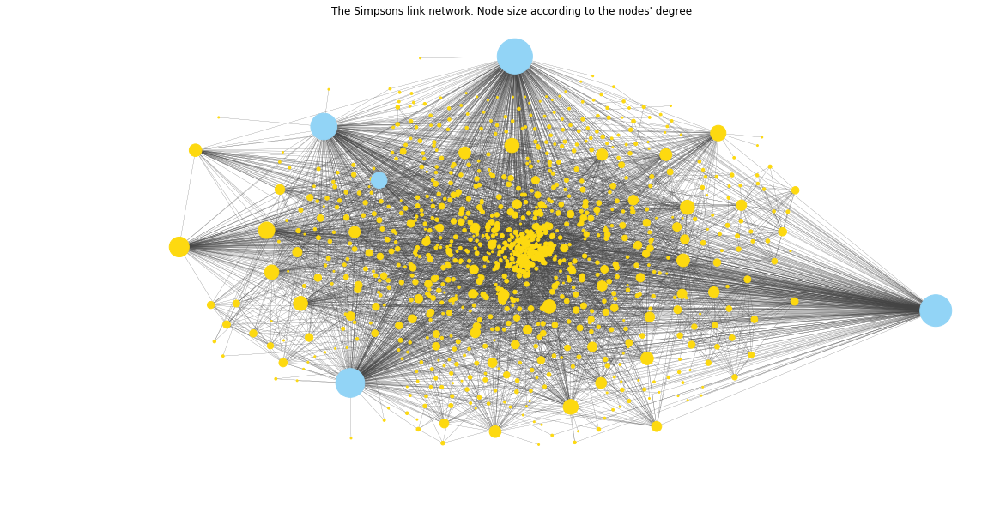

In [10]:
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=True,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=0.0001,
                          strongGravityMode=False,
                          gravity=2,

                          # Log
                          verbose=False)

positions = forceatlas2.forceatlas2_networkx_layout(SimpsonsFacebook, pos=None, iterations=2000)

fig = plt.figure(figsize=(20,10))
nx.draw_networkx(
    SimpsonsFacebook, 
    positions, 
    cmap=plt.get_cmap('jet'), 
    node_size=[d*4 for d in degrees],
    width=0.2,
    linewidths=1,
    node_color= colors,
    edge_color = '#424242',
    with_labels=False,
    arrows=False
#     with_labels=True,
#     font_size = 5
)
plt.axis('off')
plt.title('The Simpsons link network. Node size according to the nodes\' degree')
plt.show()

The above networks shows the social network of The Simpsons universe's "recurring characters", connecting characters (nodes) by the hyperlinks to other characters in their Wiki profile pages. This network displays the character connections as would be seen if we were able to capture a snapshot of a Facebook network in the Simpsons universe. From here on, we will refer to this as the "Facebook network". Node size is determined by its degree. As you can see, the 4 largest nodes (and a 5th large node) are blue and denote members of the Simpsons family. The 5th node is Maggie Simpson, who appears in significantly fewer episodes than the rest of the title family. 

As is expected, there are a small number of large nodes. However, there is a considerable number of medium-sized nodes. This is likely due to the tendency of episodes to include a large number of characters. The Wikipedia entries count all appearances in episodes (even cameos in the background), and the producers tend to include characters irrelevant to an episode's plot in a "Where's Waldo?" fashion. Thus, we would expect "recurring characters" to recur regardless of their connection in an episode's plot. 

## Network Statistics

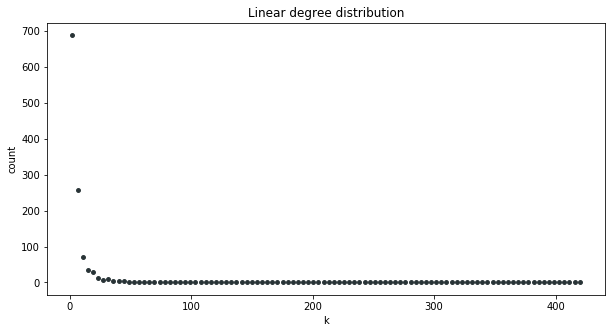

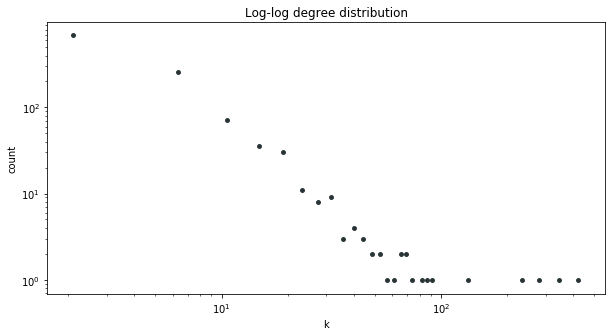

In [11]:
# Calculating data for degree distribution visualisation
degrees = [d for n, d in SimpsonsFacebook.degree]
hist, bin_edges = np.histogram(degrees,100)

# Plotting the degree distribution
fig = plt.figure(figsize=(10,5))
center = (bin_edges[:-1] + bin_edges[1:]) / 2
plt.scatter(center,hist,15, c="#283336")
plt.title("Linear degree distribution")
plt.xlabel("k")
plt.ylabel("count")
plt.show()

fig = plt.figure(figsize=(10,5))
ax = plt.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('k')
plt.title("Log-log degree distribution")
plt.xlabel("k")
plt.ylabel("count")
for i, value in enumerate(center):
    ax.scatter(value,hist[i],15, c = '#283336')

We see the linear degree distribution follows the power law, as does the log-log distribution. Interestingly, the distributions appear to be implying a disassortative network. However, in the network, we see that the high-degree nodes are very much connected. While disassortative networks typically see hubs avoid connecting with each other, the Facebook network sees the smallest nodes connecting to the title characters. These would include characters like a one-time substitute teacher for Bart Simpson or a seldom-seen classmate of Lisa Simpson. The small size of these nodes and their tendency to connect mainly (or even solely) to main characters appears to balance out the connection of the few hubs. 

In [12]:
# Calculating centralities
b = nx.betweenness_centrality(SimpsonsFacebook)
betweennessList = sorted(b.items(), key=lambda kv: kv[1], reverse=True)
e = nx.eigenvector_centrality(SimpsonsFacebook)
eigenList = sorted(e.items(), key=lambda kv: kv[1], reverse=True)

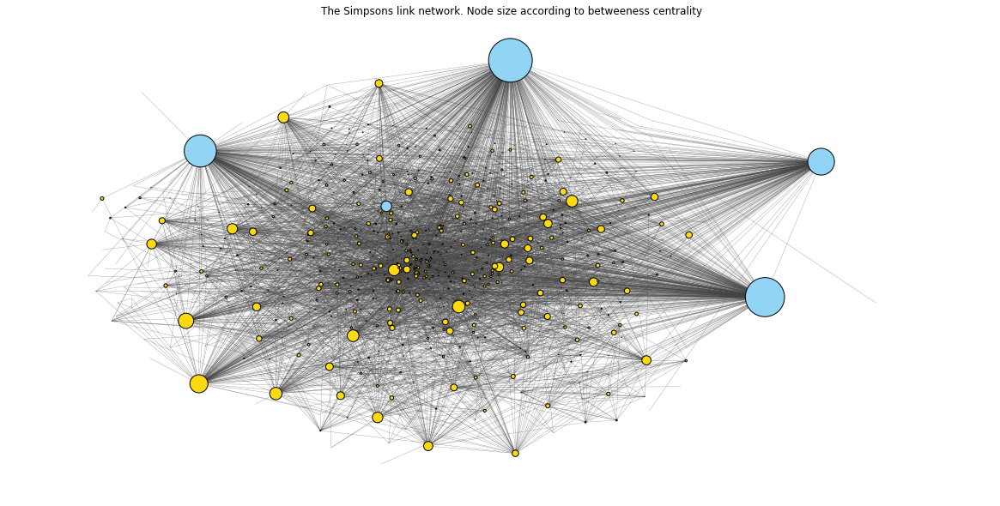

In [13]:
# Calculating centralities
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=True,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=0.0001,
                          strongGravityMode=False,
                          gravity=2,

                          # Log
                          verbose=False)

positions = forceatlas2.forceatlas2_networkx_layout(SimpsonsFacebook, pos=None, iterations=500)

fig = plt.figure(figsize=(20,10))
nx.draw_networkx(
    SimpsonsFacebook, 
    positions, 
    cmap=plt.get_cmap('jet'), 
    node_size=[b*10000 for b in list(b.values())],
    width=0.2,
    linewidths=1,
    node_color= colors,
    edge_color = '#424242',
    with_labels=False,
    arrows=False,
    edgecolors='#000000'
#     with_labels=True,
#     font_size = 5
)
plt.axis('off')
plt.title('The Simpsons link network. Node size according to betweeness centrality')
plt.show()

In [14]:
print('As we would expect here are the top characters in terms of betweeness centrality:')
betweennessList[:10]

As we would expect here are the top characters in terms of betweeness centrality:


[('Homer Simpson', 0.25945523509128493),
 ('Bart Simpson', 0.20814224694597586),
 ('Lisa Simpson', 0.14107718299145522),
 ('Marge Simpson', 0.09720040844028922),
 ('Charles Montgomery Burns', 0.044056625391931566),
 ('Krusty the Clown', 0.03194443848820269),
 ('Audrey McConnell', 0.02145787912902961),
 ('Ned Flanders', 0.02074649127708071),
 ('Milhouse Van Houten', 0.01862918112663917),
 ('Seymour Skinner', 0.01847724753546085)]

As the betweenness centrality shows the typicality of a node to be included in a shortest path between any 2 nodes, these characters' rank appears to make sense. The top 4 are the non-infant title characters, while the 5th and 6th are significant figures in the Simpsons community. Mr. Burns and Krusty appear in a large number of episodes and have interacted with a large number of nodes in the network, as they are important to the community as the rich man who owns a large employer of Springfield and television show host, respectively. 

To a lesser extent, the next 3 likely have a high betweenness centrality due to their proximity to title characters. Milhouse and Seymour are significant parts of Bart and Lisa's school community, and Ned is a next-door neighbor to the Simpsons. 

Audrey McConnell is an interesting case. Digging into her neighbors (and their neighbors, in turn) we see: 

In [15]:
for student in list(SimpsonsFacebook.neighbors("Audrey McConnell")):
    print(student)
    
print()
for student in list(SimpsonsFacebook.neighbors("Audrey McConnell's Student 1")):
    print(student)
    
print()
for student in list(SimpsonsFacebook.neighbors("Audrey McConnell's Student 2")):
    print(student)

print()
for student in list(SimpsonsFacebook.neighbors("Audrey McConnell's Student 4")):
    print(student)

Ashley
Ashley (3rd Grader)
Audrey McConnell's Student 1
Audrey McConnell's Student 2
Audrey McConnell's Student 4
Boy with bangs
Boy with freckles
Boy with glasses
Brown-haired girl
Dakota (Orange)
Female Twin
Girl with ponytail
Kevin (Stealing First Base)
Kyle's Sister
Male Twin
Bart Simpson
Lisa Simpson
Elizabeth Hoover
Edna Krabappel
Morgan (3rd Grader)
Mr. Benzie's Students
Mrs. Rhenquist
Rex (Bart of Darkness)
Sara (Student)
Tyler (Female 3rd Grader)
Tyler (Male 3rd Grader)

Q-Bert Spuckler
Audrey McConnell

Audrey McConnell
Elizabeth Hoover

Audrey McConnell


3 of these students are "Audrey McConnell's Student". Looking at their sets of neighbors, we see their only main connection is Audrey McConnell. The remote nature of these nodes (and Audrey's proximity to Lisa Simpson in the network) gives Audrey a significant increase in her betweenness centrality value. 

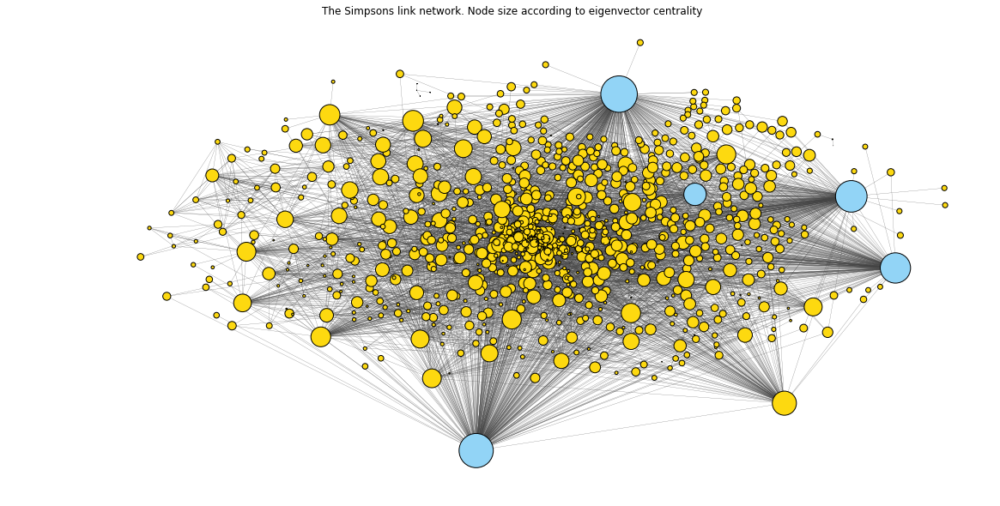

In [16]:
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=True,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=0.0001,
                          strongGravityMode=False,
                          gravity=2,

                          # Log
                          verbose=False)

positions = forceatlas2.forceatlas2_networkx_layout(SimpsonsFacebook, pos=None, iterations=500)

fig = plt.figure(figsize=(20,10))
nx.draw_networkx(
    SimpsonsFacebook, 
    positions, 
    cmap=plt.get_cmap('jet'), 
    node_size=[e*5000 for e in list(e.values())],
    width=0.2,
    linewidths=1,
    node_color= colors,
    edge_color = '#424242',
    with_labels=False,
    arrows=False,
    edgecolors='#000000'
#     with_labels=True,
#     font_size = 5
)
plt.axis('off')
plt.title('The Simpsons link network. Node size according to eigenvector centrality')
plt.show()

In [17]:
print('We can see that the characters related more closely to the Simpson core family have higher eigenvector centrality:')
eigenList[:10]

We can see that the characters related more closely to the Simpson core family have higher eigenvector centrality:


[('Homer Simpson', 0.36134419016165686),
 ('Bart Simpson', 0.3180201055746984),
 ('Lisa Simpson', 0.2705804059852466),
 ('Marge Simpson', 0.249082836343306),
 ('Charles Montgomery Burns', 0.15764950811628153),
 ('Maggie Simpson', 0.136259089544148),
 ('Abraham Simpson II', 0.11814398872790245),
 ('Ned Flanders', 0.11311300999618094),
 ('Krusty the Clown', 0.10649589629489985),
 ('Seymour Skinner', 0.10176771899874372)]

With the eigenvector centrality, we see many names from the betweenness centrality list. However, there are 2 new additions: Maggie Simpson and Abraham Simpson II. Neither of these 2 characters have a high betweenness centrality because they have very few social connections in the show, making their inclusion in short paths somewhat cumbersome. However, they are heavily connected to the Simpsons family (being a part of it themselves) and Montgomery Burns (the 5th highest-connected node). 

## Removing the Simpsons

The main aspect of the Facebook network that differentiates it from a real social network are the ubiquitous Simpsons. In the real world, no average family would have connections to such a high percentage of nodes. To explore a more realistic version of the network, we are able to remove the Simpsons and see the impact this has on our statistics. 

In [18]:
# Removing the Simpsons from the network
SimpsonsFacebook_noSimpsons = SimpsonsFacebook.copy()
SimpsonsFacebook_noSimpsons.remove_nodes_from(simpsons_family)

In [19]:
# Exporting the network to JSON for the Website:
for node in list(SimpsonsFacebook_noSimpsons.nodes()):
    SimpsonsFacebook_noSimpsons.nodes[node]['degree'] = SimpsonsFacebook_noSimpsons.degree(node)

with open('exported_networks/SimpsonsFacebook_noSimpsons.json','w') as fp:
    data = json_graph.cytoscape_data(SimpsonsFacebook_noSimpsons)
    json.dump(data, fp)
    fp.close()

In [20]:
# Recalculating the degrees for the new network
degrees = [d for n, d  in SimpsonsFacebook_noSimpsons.degree]

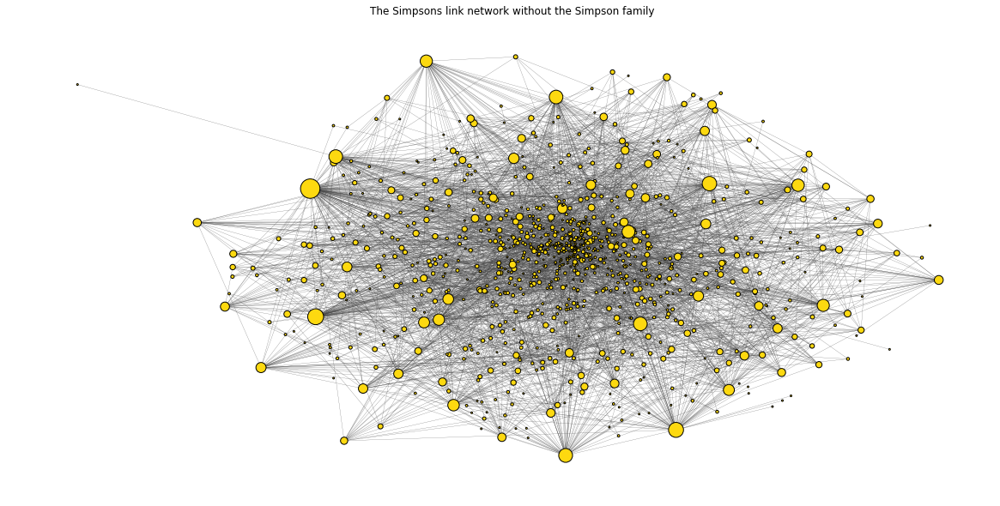

In [21]:
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=True,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=0.0001,
                          strongGravityMode=False,
                          gravity=2,

                          # Log
                          verbose=False)

positions = forceatlas2.forceatlas2_networkx_layout(SimpsonsFacebook_noSimpsons, pos=None, iterations=500)

fig = plt.figure(figsize=(20,10))
nx.draw_networkx(
    SimpsonsFacebook_noSimpsons, 
    positions, 
    cmap=plt.get_cmap('jet'), 
    node_size=[d*4 for d in degrees],
    width=0.2,
    linewidths=1,
    node_color= "#fdd910",
    edge_color = '#424242',
    with_labels=False,
    edgecolors="#000000",
    arrows=False
)
plt.axis('off')
plt.title('The Simpsons link network without the Simpson family')
plt.show()

As suggested above, we see more features that would we would expect to see in a real-world network. The most obvious is the distribution of node size. While there are several noticeable hubs, they don't appear to have anywhere near the reach the Simpsons did. Addiitonally, there were no discernable non-contiguous communities. On the bottom-left side of the graph are 2 small nodes that are attached to each other and nothing else. As in real-world networks, there are groups which are separated from the rest of the network. While it is still hard to draw much more insight from the season 1 graph than the full network, these features show the Facebook network is more realistic without the Simpsons.

## Network statistics for the link network without the Simpsons

In [22]:
degreeList = sorted(SimpsonsFacebook_noSimpsons.degree, key=lambda x: x[1], reverse=True)
degreeList[0]

('Charles Montgomery Burns', 128)

The highest degree node is Mr. Burns after removing the Simpsons

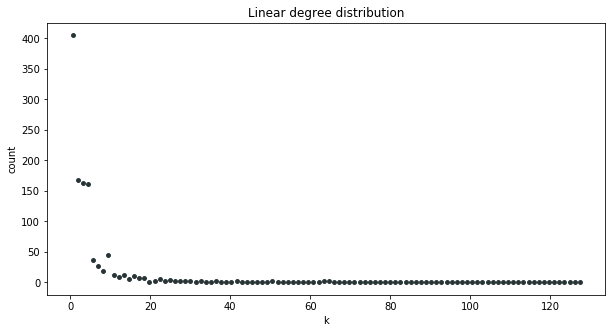

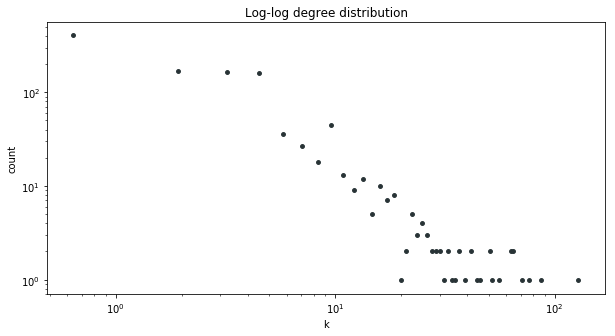

In [23]:
degrees = [d for n, d in SimpsonsFacebook_noSimpsons.degree]
hist, bin_edges = np.histogram(degrees,100)

fig = plt.figure(figsize=(10,5))
center = (bin_edges[:-1] + bin_edges[1:]) / 2
plt.scatter(center,hist,15, c="#283336")
plt.title("Linear degree distribution")
plt.xlabel("k")
plt.ylabel("count")
plt.show()

fig = plt.figure(figsize=(10,5))
ax = plt.gca()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('k')
plt.title("Log-log degree distribution")
plt.xlabel("k")
plt.ylabel("count")
for i, value in enumerate(center):
    ax.scatter(value,hist[i],15, c = '#283336')

The most obvious difference here is the value range of axes. On the upper plot, the Y axis goes only to 400 and the X axis goes only to 120 (instead the previous 700 and 400). This tells us, that the maximum degree has gotten smaller significantly.
While these graphs don't appear to be much different than the graphs with the Simpsons, they do at least follow the power law for the linear and log-log degree distributions.

In [24]:
# Centralities
b = nx.betweenness_centrality(SimpsonsFacebook_noSimpsons)
betweennessList = sorted(b.items(), key=lambda kv: kv[1], reverse=True)
e = nx.eigenvector_centrality(SimpsonsFacebook_noSimpsons)
eigenList = sorted(e.items(), key=lambda kv: kv[1], reverse=True)

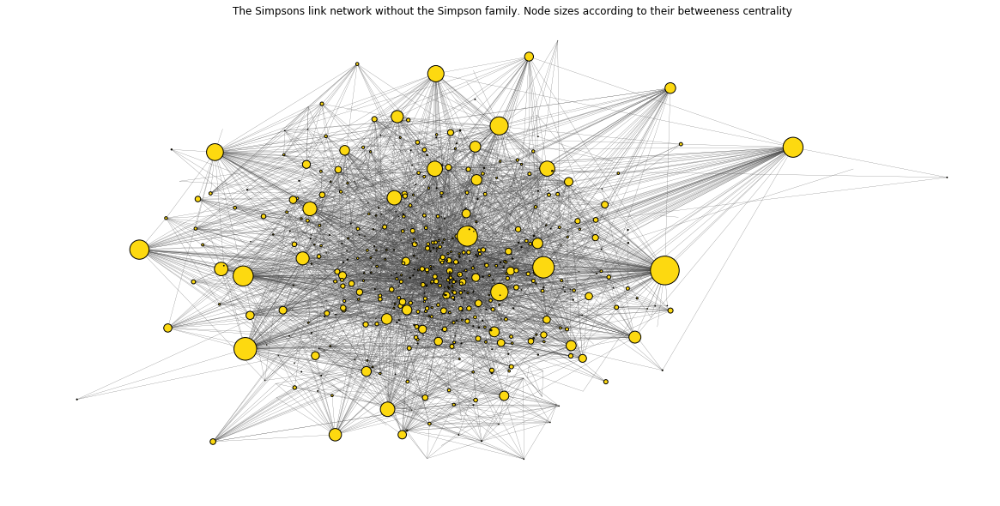

In [25]:
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=True,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=0.0001,
                          strongGravityMode=False,
                          gravity=2,

                          # Log
                          verbose=False)

positions = forceatlas2.forceatlas2_networkx_layout(SimpsonsFacebook_noSimpsons, pos=None, iterations=500)

fig = plt.figure(figsize=(20,10))
nx.draw_networkx(
    SimpsonsFacebook_noSimpsons, 
    positions, 
    cmap=plt.get_cmap('jet'), 
    node_size=[b*10000 for b in list(b.values())],
    width=0.2,
    linewidths=1,
    node_color= '#fdd910',
    edge_color = '#424242',
    with_labels=False,
    edgecolors="#000000",
    arrows=False
)
plt.axis('off')
plt.title('The Simpsons link network without the Simpson family. Node sizes according to their betweeness centrality')
plt.show()

Comparing this to the previous iteration, we node size is more evenly distributed here as well. Without the Simpsons' reach to so many nodes, the shortest paths between nodes are forced to travel to a more diverse set of nodes. Around the edge are several seemingly non-existent nodes that likely only connect to one other node now that the Simpsons are gone. Additionally, this spread of betweenness centrality illustrates the fact that the formation of defined communities is possible without the Simpsons. We are better able to see that certain groupings of nodes.

In [26]:
betweennessList[:10]

[('Charles Montgomery Burns', 0.11192172829827543),
 ('Krusty the Clown', 0.06982887463990488),
 ('Milhouse Van Houten', 0.06239626062839648),
 ('Nelson Muntz', 0.05598887906605674),
 ('Ned Flanders', 0.055050560754013565),
 ('Seymour Skinner', 0.0541850151440683),
 ('Edna Krabappel', 0.050073715829503644),
 ('Moe Szyslak', 0.04450633549964461),
 ('Audrey McConnell', 0.04128740364284259),
 ('Abraham Simpson II', 0.03860676831968521)]

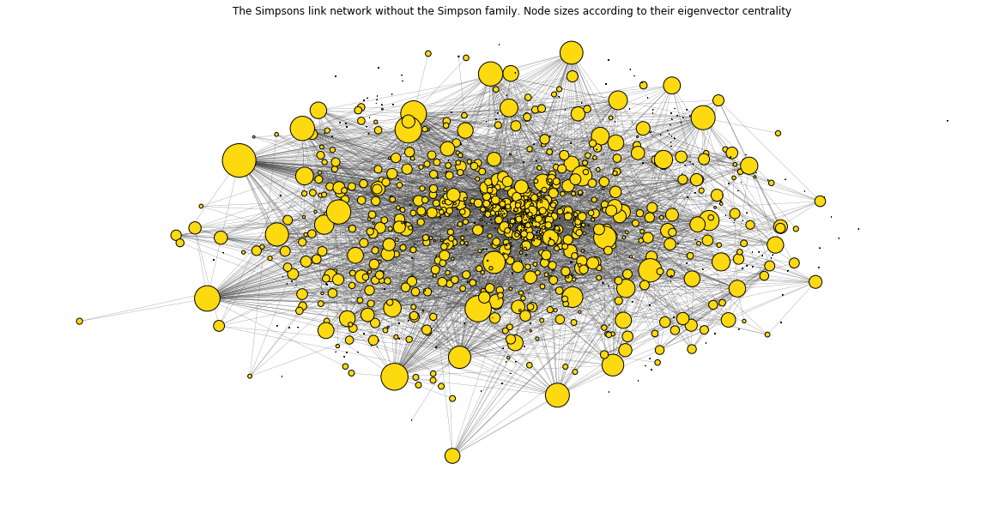

In [27]:
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=True,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=0.0001,
                          strongGravityMode=False,
                          gravity=2,

                          # Log
                          verbose=False)

positions = forceatlas2.forceatlas2_networkx_layout(SimpsonsFacebook_noSimpsons, pos=None, iterations=500)

fig = plt.figure(figsize=(20,10))
nx.draw_networkx(
    SimpsonsFacebook_noSimpsons, 
    positions, 
    cmap=plt.get_cmap('jet'), 
    node_size=[e*5000 for e in list(e.values())],
    width=0.2,
    linewidths=1,
    node_color= '#fdd910',
    edge_color = '#424242',
    with_labels=False,
    edgecolors="#000000",
    arrows=False
)
plt.axis('off')
plt.title('The Simpsons link network without the Simpson family. Node sizes according to their eigenvector centrality')
plt.show()

The main difference of this graph to the previous version is that there are several miniscule nodes surrounding the main cluster. These are likely characters that previously only had one-time appearances. For instance, recall the Audrey McConnell Students we mentioned before.

In [28]:
for student in list(SimpsonsFacebook_noSimpsons.neighbors("Audrey McConnell's Student 1")):
    print(student)
    
print()
for student in list(SimpsonsFacebook_noSimpsons.neighbors("Audrey McConnell's Student 2")):
    print(student)

print()
for student in list(SimpsonsFacebook_noSimpsons.neighbors("Audrey McConnell's Student 4")):
    print(student)
    
print()
    
for student in list(SimpsonsFacebook_noSimpsons.neighbors("Audrey McConnell")):
    print(student)
    
print()

for student in list(SimpsonsFacebook_noSimpsons.neighbors("Elizabeth Hoover")):
    print(student)

Q-Bert Spuckler
Audrey McConnell

Audrey McConnell
Elizabeth Hoover

Audrey McConnell

Ashley
Ashley (3rd Grader)
Audrey McConnell's Student 1
Audrey McConnell's Student 2
Audrey McConnell's Student 4
Boy with bangs
Boy with freckles
Boy with glasses
Brown-haired girl
Dakota (Orange)
Female Twin
Girl with ponytail
Elizabeth Hoover
Kevin (Stealing First Base)
Edna Krabappel
Kyle's Sister
Male Twin
Morgan (3rd Grader)
Mr. Benzie's Students
Mrs. Rhenquist
Rex (Bart of Darkness)
Sara (Student)
Tyler (Female 3rd Grader)
Tyler (Male 3rd Grader)

Afro Girl
Audrey McConnell's Student 2
Chuck Berger
Mr. Bergstrom
Brown-haired boy
Bumblebee Man
Christopher Columbus
Ned Flanders
Doris Freedman
Jonathan Frink
Girl with necklace
Groundskeeper Willie
Ralph Wiggum
Edna Krabappel
Apu Nahasapeemapetilon
Cletus Spuckler
Jenda Simpson
Hubert Wong
Jacques
Lisa's Classmate 1
Lisa's Classmate 2
Lisa's Classmate 3
Lisa's Classmate 4
Luann Van Houten
Audrey McConnell
Nina Skalka


We see that the students' common connection was Audrey, who was a relatively small node. However, Student 2's other connection is Elizabeth Hoover. Miss Hoover is a much more well-connected node. Thus, we would likely see a small community form around Audrey McConnell and her students with extremely low eigenvector centrality.


In [29]:
eigenList[:10]

[('Charles Montgomery Burns', 0.306079903383079),
 ('Ned Flanders', 0.19769836259617368),
 ('Seymour Skinner', 0.19172025832772077),
 ('Moe Szyslak', 0.18757410606691893),
 ('Abraham Simpson II', 0.18031436748812252),
 ('Krusty the Clown', 0.17669492151295915),
 ('Milhouse Van Houten', 0.16120944170002058),
 ('Robert Terwilliger', 0.15993789705327552),
 ('Clancy Wiggum', 0.15972692489675913),
 ('Barney Gumble', 0.1578432055501647)]

In conclusion, the removal of the Simpsons from the network has several significant impacts. The majority of the network has more evenly spread degree and betweenness centrality, showing the nodes are more equal. However, the small nodes that relied on the Simpsons as their primary collections appear to be hard-pressed to find a good replacement in many cases.

# Appearance Network

To complement the Facebook network, we created a second network that connects nodes based on if the corresponding characters appeared in the same episode. We created the network a bipartite graph with one set of nodes as the characters and the other as the episodes they appeared in. 

From there, we are able to create undirected networks of each season by projecting each node's episode connections to the other characters that appeared in that episode. Using this "appearance network", we are able to see each character's popularity arcs throughout the show. Additionally, we are able to see how closely linked a pair of characters is by calculting the percentage of episodes the characters appear together compared to their total appearances. 

In [30]:
# This is needed in order to apply the simplest projection method
print('The bipartite network is connected: ',nx.is_connected(BiAppearance))

# Dividing the bipartite network to make it possible to connect Homer to every episode
character_nodes, episode_nodes = bipartite.sets(BiAppearance)

The bipartite network is connected:  True


In [31]:
# Adding Homer and connect him to every episode because he has no appearances section on his page
BiAppearance.add_node('Homer Simpson', bipartite=0)
for e in episode_nodes:
    BiAppearance.add_edge('Homer Simpson',e)

BiAppearance.remove_node(None)

In [32]:
# Exporting the network to JSON for the Website:
for node in list(BiAppearance.nodes()):
    BiAppearance.nodes[node]['degree'] = BiAppearance.degree(node)

with open('exported_networks/BiAppearance.json','w') as fp:
    data = json_graph.cytoscape_data(BiAppearance)
    json.dump(data, fp)
    fp.close()

In [33]:
# Dividing the bipartite network
character_nodes, episode_nodes = bipartite.sets(BiAppearance)

In [34]:
# Checking the character set of nodes
character_nodes

{'Red Barclay',
 'Marge Simpson',
 'Shauna Chalmers',
 "Mike's Student 2",
 'Lisa Simpson',
 'Tom The Turkey',
 'Les',
 'The Rich Texan',
 'Grandpa Van Houten',
 'Mr. McIntyre',
 'Mexican Duffman',
 'Sophie Krustofsky',
 "Homer's clones",
 'Grand Pumpkin',
 'Number One',
 'Clancy Wiggum',
 'Stephen Hawking (character)',
 'Ham',
 'Charcoal Briquette',
 'Cecile Shapiro',
 'Cowboy Bob',
 'Contractor',
 'Bleeding Gums Murphy',
 'Darcy',
 'Incest Spuckler',
 'Mr. Bont',
 'An Alien',
 "Sherri and Terri's sister",
 'Senator Mendoza',
 "Mike (Homer's Night Out)",
 'Homer Simpson',
 'Grim Reaper',
 'Jason Voorhees',
 'Fallout Boy',
 'Duff Daughter',
 'C.H.U.M.',
 'Bernie Sanders',
 'Kodos',
 'Ernst',
 'Gnome in your Home',
 'David Copperfield (character)',
 'Popular Girl 3',
 'Ms. Mellon',
 "Dr. Hibbert's Second Daughter",
 'Joe Namath (Character)',
 "Audrey McConnell's Student 2",
 'Wanda',
 'Jaffee Ziswhisky',
 'Q-Bert Spuckler',
 'King Homer (character)',
 'Bob Dole',
 'Martin Prince',
 'Art

In [35]:
# Creating the Appearance network by projecting the character part of the network as a weighted graph
AppearanceNetwork = bipartite.weighted_projected_graph(BiAppearance,character_nodes)

In [36]:
# Exporting the network to JSON for the Website:
for node in list(AppearanceNetwork.nodes()):
    AppearanceNetwork.nodes[node]['degree'] = AppearanceNetwork.degree(node)

with open('exported_networks/AppearanceNetwork.json','w') as fp:
    data = json_graph.cytoscape_data(AppearanceNetwork)
    json.dump(data, fp)
    fp.close()

## Calculating the strength of the connections between characters

We wanted to measure how correlated are two characters to each other. To do that we created a formula which is going to give us the 'strength' of the connection between two characters.

\begin{equation*}
Connection Score (character_A, character_B) = \frac{{nr. of appearance}_{together}}{{nr. of appearance}_{character_A}+{nr. of appearance}_{character_B}-{nr. of appearance}_{together}}
\end{equation*}

In [37]:
print('Connection score between Bart and Lisa:', AppearanceNetwork['Bart Simpson']['Lisa Simpson']['weight'] / len(episode_nodes))

Connection score between Bart and Lisa: 0.9228395061728395


As expected, Bart and Lisa Simpson are highly connected. Characters that appear in such a high number of shows are bound to have a high connection because there is such little room for them to appear in episodes without the other character. 

In [38]:
apuDegree = BiAppearance.degree('Apu Nahasapeemapetilon')
comicDegree = BiAppearance.degree('Comic Book Guy')
together = AppearanceNetwork['Apu Nahasapeemapetilon']['Comic Book Guy']['weight']

print('Apu, Comic Book Guy:', together/(apuDegree+comicDegree-together))

Apu, Comic Book Guy: 0.16831683168316833


Comparing Apu and Comic Book Guy, we see they aren't very highly correlated. Of all the episodes in which they appear, less than 17% of them include both characters. Thus, we are able to confirm that these two chracters that appear to be unrelated from a viewer are proven unrelated from an appearance standpoint as well.

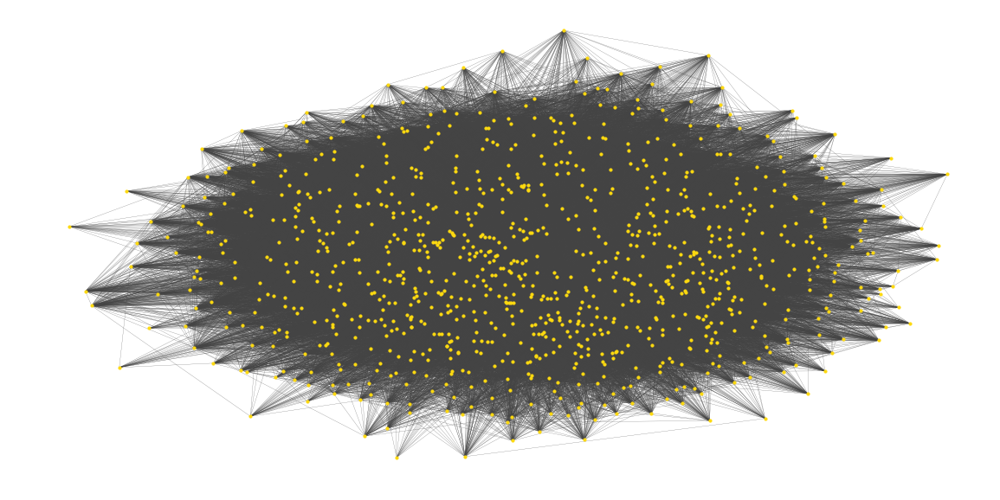

In [39]:
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=True,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=0.0001,
                          strongGravityMode=False,
                          gravity=2,

                          # Log
                          verbose=False)

positions = forceatlas2.forceatlas2_networkx_layout(AppearanceNetwork, pos=None, iterations=500)

fig = plt.figure(figsize=(20,10))
nx.draw_networkx(
    AppearanceNetwork, 
    positions, 
    cmap=plt.get_cmap('jet'), 
    node_size=10,
    width=0.2,
    linewidths=1,
    node_color= '#fdd910',
    edge_color = '#424242',
    with_labels=False
)
plt.axis('off')
plt.show()

Above, we see the appearance network in its highly-connected glory. By narrowing the network to the appearances from specific seasons,  these significantly less dense networks give visual information about character connections and also are able to show characters that are important in the season. 

Below, the appearance network is reduced to only include episodes from season 1. While we see there are several large nodes, there are also well-defined communities separated from the main mass of nodes. An easily explainable cluster is to the bottom-right and contains a pair of news reports, "Bigfoot", and  "Scary Vultures". In the show, Bigfoot and the Scary Vultures are featured on the news, so they would obviously be connected in the graph.

In [40]:
seasons = get_season_dictionary()

In [41]:
# Exporting every Seasons' appearance network to JSON for the Website:
for season_nr in seasons.keys():
    CurrentSeason = BiAppearance.copy()
    CurrentSeason.remove_nodes_from([e for e in episode_nodes if e not in seasons[season_nr]])
    CurrentSeason = bipartite.weighted_projected_graph(CurrentSeason,character_nodes)
    
    for c in character_nodes:
        if CurrentSeason.degree(c) == 0:
            CurrentSeason.remove_node(c)
    
    for node in list(CurrentSeason.nodes()):
        CurrentSeason.nodes[node]['degree'] = CurrentSeason.degree(node)

    with open(f'exported_networks/season_appearances/Season{season_nr}.json','w') as fp:
        data = json_graph.cytoscape_data(CurrentSeason)
        json.dump(data, fp)
        fp.close()

In [42]:
Season1 = BiAppearance.copy()
Season1.remove_nodes_from([e for e in episode_nodes if e not in seasons[1]])

Season1 = bipartite.weighted_projected_graph(Season1,character_nodes)

# Removing the characters nodes which have no appearance in Season1
for c in character_nodes:
    if Season1.degree(c) == 0:
        Season1.remove_node(c)

In [43]:
degrees1 = [d for n, d  in Season1.degree]

Text(0.5,1,'Appearance Network for Season 1')

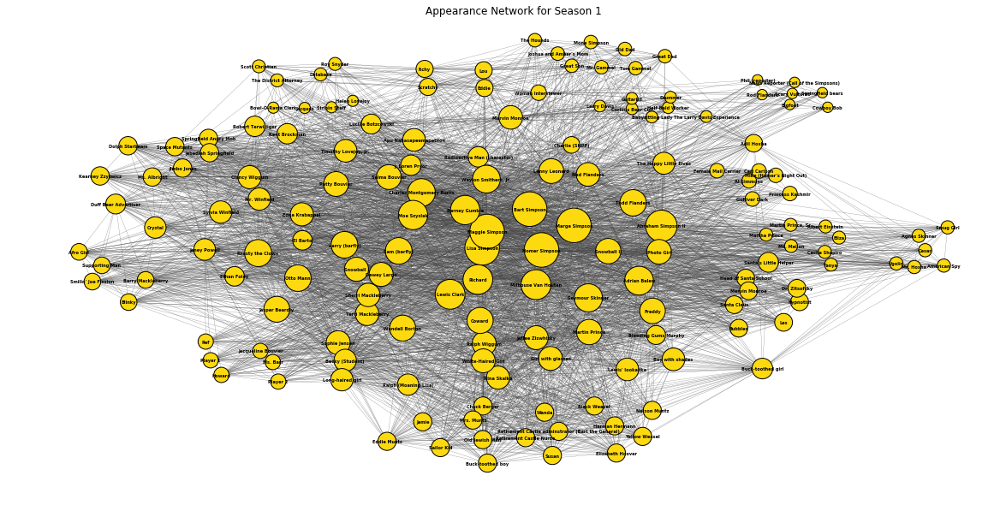

In [44]:
forceatlas2 = ForceAtlas2(
                          # Behavior alternatives
                          outboundAttractionDistribution=False,  # Dissuade hubs
                          linLogMode=False,  # NOT IMPLEMENTED
                          adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                          edgeWeightInfluence=1.0,

                          # Performance
                          jitterTolerance=1.0,  # Tolerance
                          barnesHutOptimize=True,
                          barnesHutTheta=1.2,
                          multiThreaded=False,  # NOT IMPLEMENTED

                          # Tuning
                          scalingRatio=1,
                          strongGravityMode=False,
                          gravity=1,

                          # Log
                          verbose=False)

positions = forceatlas2.forceatlas2_networkx_layout(Season1, pos=None, iterations=5000)

fig = plt.figure(figsize=(20,10))
nx.draw_networkx(
    Season1, 
    positions, 
    cmap=plt.get_cmap('jet'), 
    node_size=[d*10 for d in degrees1],
    width=0.2,
    linewidths=1,
    node_color= '#fdd910',
    edge_color = '#424242',
    edgecolors = '#000000',
    with_labels=True,
    font_size = 5,
    font_weight = 'bold'
)
plt.axis('off')
plt.title('Appearance Network for Season 1')
#plt.savefig('season1_network.png', dpi=500)
#plt.show()

Due to the low resolution of the ForceAtlas output, we also saved the figure to a .png file. Below you can see a  exported version below. The resolution is high enough to zoom in and read the labels on the nodes clearly.

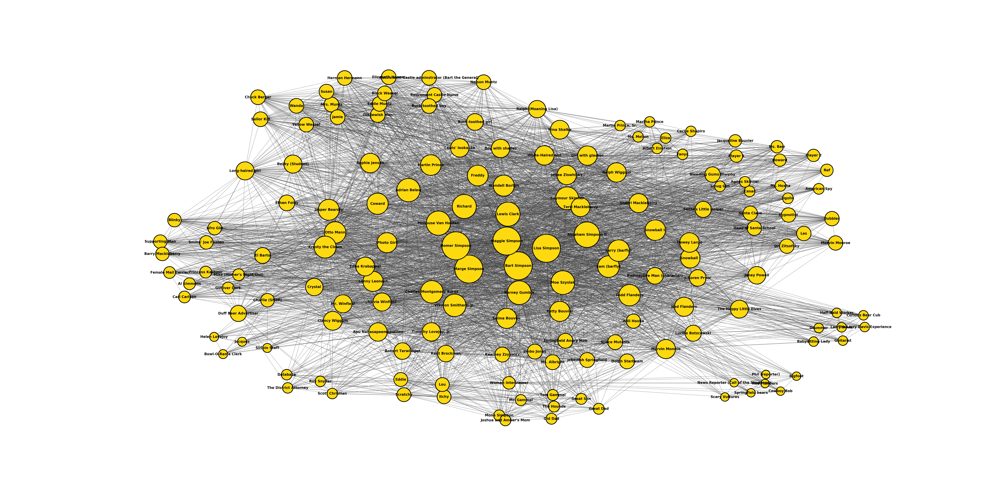

In [45]:
Image("data_prep/season1_network.png")

Though we are largely unable to draw important insight from the graph, we are still able to manipulate the data to see characters' introductions to the show, their rise in popularity, and how well they stayed in prevalence. For example, **Comic Book Guy** appears to have bursts of popularity before largely disappearing, while **Charles Montgomery Burns** (Mr. Burns) has a more consistent role in the show. Feel free to explore using any of the names in the network.

Input a name (type 'help' for available characters): Comic Book Guy


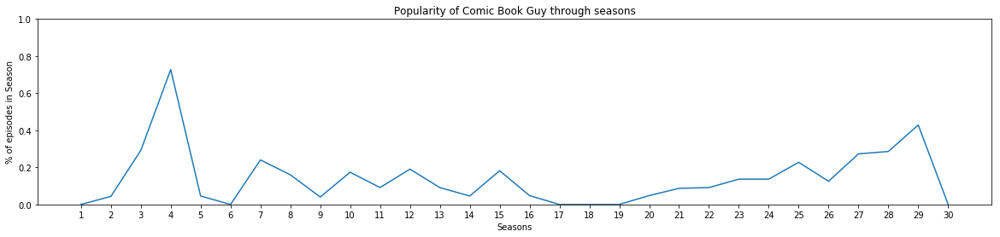

In [46]:
name = input('Input a name (type \'help\' for available characters): ')
if name == 'help':
    for c in character_nodes:
        print(c)
else:
    appearances_through_seasons = []
    for i in seasons.keys():
        # Create a tmp copy for the actual season based on the complete network
        Season = BiAppearance.copy()
        # Remove all the nodes which are not in the actual season
        Season.remove_nodes_from([e for e in episode_nodes if e not in seasons[i]])
        # Check the degree as a 'popularity' factor
        #print('Season ',i,': ',Season.degree(name))
        
        # Building the list for the plot's y axis. 
        # There's more meaning to show the percentage than the number itself, 
        # because the episode number can vary between seasons
        appearances_through_seasons.append(Season.degree(name)/len(seasons[i]))

    fig = plt.figure(figsize=(20,4))
    plt.plot(np.arange(1,31), appearances_through_seasons)
    plt.ylim(0,1)
    plt.ylabel('% of episodes in Season')
    plt.xlabel('Seasons')
    plt.xticks(np.arange(1,31))
    plt.title(f'Popularity of {name} through seasons')
    plt.show()

We measure the 'Popularity' by counting the number of appearances per season. On the Y axis you can see the $\frac{nr. of episodes the character appeared in}{nr. of episodes in season}$ ratio in percentage. We can make this counting possible by copying our bipartite appearance network (characters and episodes) to a new network for every season and then remove every episode node which is not in the given season. After this we can easily count the degree of the given character node.

# Word Clouds

As a more entertaining way to show off the Simpsons universe, we retrieved the total quotes of each episode from the Simpsons Wiki. While the Wiki doesn't have exhaustive episode scripts, it does have many iconic quotes. This should give word clouds accurately representing the unique vocabularies of the characters. To determine the string to be used in the word cloud function, a character's vocabulary corpus will be compared to each other character's in order to calculate the size of their most unique words using the tf-idf. 

Due to the relatively sparse number of quotes from non-title characters, we have elected to create word clouds for just a few characters that have a sufficient number of words. Fans of the Simpsons will see several recurring words and phrases in each cloud. For example, Homer has: "doh", the names of the other family members, "stupid", and "flanders". Similarly, Lisa has: "mom", "dad", "school", and "jazz". 

In [47]:
# Opening the previously exported TF-IDF scores for each character
with open("data_prep/characterQuoteStringsTfIdf.json") as f:
    tfidfDict = json.load(f)
f.close()

In [48]:
#Homer
homer_coloring = np.array(PIL.Image.open('pictures/Homer_Simpson.jpg'))
wc_homer = WordCloud(background_color="white",
                     max_words=4000,
                     mask=homer_coloring,
                     max_font_size=100,
                     random_state=42,
                     collocations=False)

#Marge
marge_coloring = np.array(PIL.Image.open('pictures/Marge_Simpson.jpeg'))
wc_marge = WordCloud(background_color="white",
                     max_words=4000,
                     mask=marge_coloring,
                     max_font_size=100,
                     collocations = False,
                     random_state=42)

#Bart
bart_coloring = np.array(PIL.Image.open('pictures/Bart_Simpson.jpg'))
wc_bart = WordCloud(background_color="white",
                    max_words=4000,
                    mask=bart_coloring,
                    max_font_size=100,
                    collocations=False,
                    random_state=42)

#Lisa
lisa_coloring = np.array(PIL.Image.open('pictures/LisaTransparent.png'))
wc_lisa = WordCloud(background_color="white",
                    max_words=4000,
                    mask=lisa_coloring,
                    max_font_size=100,
                    collocations=False,
                    random_state=42)

In [49]:
wc_homer.generate(tfidfDict['homer'])
wc_marge.generate(tfidfDict['marge'])
wc_bart.generate(tfidfDict['bart'])
wc_lisa.generate(tfidfDict['lisa'])

In [50]:
image_colors_homer = ImageColorGenerator(homer_coloring)
image_colors_marge = ImageColorGenerator(marge_coloring)
image_colors_bart = ImageColorGenerator(bart_coloring)
image_colors_lisa = ImageColorGenerator(lisa_coloring)

(-0.5, 739.5, 1199.5, -0.5)

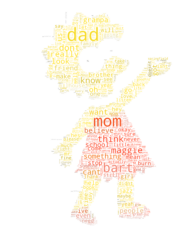

In [51]:
# Lisa
# fig = plt.figure(figsize=(20,20))
plt.imshow(wc_lisa.recolor(color_func=image_colors_lisa),interpolation="bilinear",)
plt.axis("off")
#plt.savefig("final_wordclouds/Lisa_WordCloud.png",dpi=1000)

(-0.5, 540.5, 1109.5, -0.5)

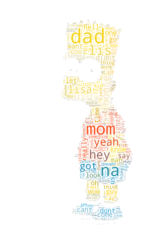

In [52]:
# Bart
# fig = plt.figure(figsize=(300,300))
plt.imshow(wc_bart.recolor(color_func=image_colors_bart),interpolation="bilinear")
plt.axis("off")
#plt.savefig("final_wordclouds/Bart_WordCloud.png",dpi=1000)

(-0.5, 1199.5, 1573.5, -0.5)

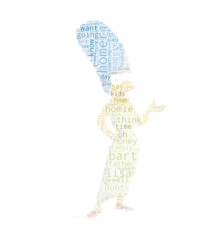

In [53]:
# Marge
# fig = plt.figure(figsize=(300,300))
plt.imshow(wc_marge.recolor(color_func=image_colors_marge),interpolation="bilinear")
plt.axis("off")
#plt.savefig("final_wordclouds/Marge_WordCloud.png",dpi=1000)

(-0.5, 1595.5, 2047.5, -0.5)

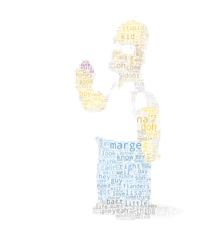

In [54]:
# Homer
# fig = plt.figure(figsize=(300,300))
plt.imshow(wc_homer.recolor(color_func=image_colors_homer),interpolation="bilinear")
plt.axis("off")
#plt.savefig("final_wordclouds/Homer_WordCloud.png",dpi=1000)

### Feel free to generate your own word cloud below. Only the Simpsons family has mask images. The rest of the characters will use an image of a Duff beer can as the mask.

Input a name (type 'help' for available characters): nelson


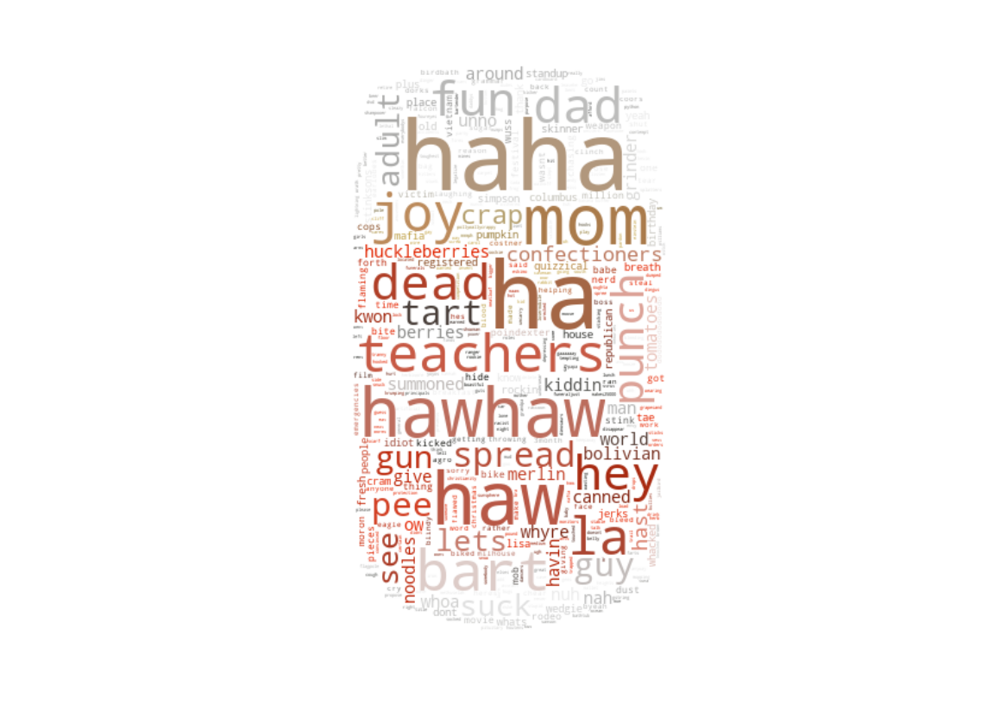

In [55]:
name = input('Input a name (type \'help\' for available characters): ')

if name == 'help':
    for name in tfidfDict.keys():
        print(name)
else:
    
    url = 'https://superawesomevectors.com/wp-content/uploads/2016/02/duff-beer-free-vector-illustration-800x566.jpg'
    response = requests.get(url)
    img = PIL.Image.open(BytesIO(response.content))
    
    coloring = np.array(img)
    
    wc = WordCloud(background_color="white",
                     max_words=4000,
                     mask=coloring,
                     max_font_size=80,
                     random_state=42,
                     collocations=False)
    
    wc.generate(tfidfDict[name])
    
    image_colors = ImageColorGenerator(coloring)
    
    fig = plt.figure(figsize=(20,20))
    plt.imshow(wc.recolor(color_func=image_colors),interpolation="bilinear",)
    plt.axis("off")
    

# Sentiment Analysis

In order to further analyze the quotes of each character, we calculate the sentiment of each character's quote corpus and give them an average score based on words that could be assigned a value. At this point, the data showed that (for the most part) every character's overall sentiment value ranged from 5-6. While this makes sense, it makes for a rather boring analysis. Even characters that are traditionally seen as evil will use positive words with a normal frequency. Mr. Burns illustrates this quite well. While he does use words like "death" or "kill", he also says "excellent" quite frequently. Because the calculation is unable to tell the menacing context in which he says "excellent", it will even out other words with low sentiment values. 

Obviously, displaying one average number per character does not divulge much information, splitting their quote corpus in to multiple buckets will show the frequency with which they use negative and positive words. Most importantly, the histograms created from the buckets will show a character's distribution sentiment. A character that has mainly word sentiment values of 5-6 can be differentiated from characters that have a high frequency of extremely low and high value words. 

After several attempts to establish the normalization range, we decided there was a need to exclude outliers. Characters with only a few words would be able to skew the range, regardless of how many words they spoke. Thus, we removed characters from the analysis that spoke less than 300 words. This gave a less extreme range in average sentiment.

In [56]:
sentimentDict={}
filePath = 'https://journals.plos.org/plosone/article/file?type=supplementary&id=info%3Adoi%2F10.1371%2Fjournal.pone.0026752.s001'
response = request.urlopen(filePath)
data = response.read()
text = data.decode('utf-8')
for line in text.split('\n')[4:]:
    listThing=line.split('\t')
    if len(listThing) > 3:
        sentimentDict[listThing[0]]=[listThing[2],listThing[3]]

#Global services 800-992-4685

#opersations 877-742-9488

#@jit(cache=True)
def sentiment(list_of_tokens):
    sentiment_num=0
    sentiment_denom=0
    for token in list_of_tokens:
        if sentimentDict.get(token):
            sentiment_num+=float(sentimentDict[token][0])
            sentiment_denom+=1
    return (sentiment_num,sentiment_denom)

with open('data_prep/characterQuotesBySeason.json') as f:
    data = json.load(f)
f.close()

personScoresPerSeason={}
happyScores={}
numberOfWords={}
characterIndividWordScores={}


for season in data: 
    for person in data[season].keys():
        strippedName=person.strip()
        if not characterIndividWordScores.get(strippedName):
            characterIndividWordScores[strippedName]={'1':0,'2':0,'3':0,'4':0,'5':0,'6':0,'7':0,'8':0,'9':0,'10':0}
        
        for word in word_tokenize(data[season][person]):
            try:
                characterIndividWordScores[strippedName][str(int(round(sentiment([word])[0])))]+=1
            except:
                pass
        #actualWords[strippedName]=[(x,sentiment([x])[0]) for x in word_tokenize(data[season][person])]
        val=sentiment(word_tokenize(data[season][person]))
        if not numberOfWords.get(strippedName):
            numberOfWords[strippedName]=0
        numberOfWords[strippedName]+=len(word_tokenize(data[season][person]))
        if not personScoresPerSeason.get(strippedName):
            personScoresPerSeason[strippedName]=[]
        personScoresPerSeason[strippedName].append(val)
      
for person in personScoresPerSeason:
    numerator=0
    denominator=0
    for item in personScoresPerSeason[person]:
        numerator+=item[0]
        denominator+=item[1]
    if denominator!=0:
        happyScores[person]=numerator/denominator
    else:
        happyScores[person]=''


k_keys_sorted = heapq.nlargest(20, numberOfWords, key=numberOfWords.get)

finalArr=[(x,happyScores[x],characterIndividWordScores[x]) for x in k_keys_sorted]
finalDict={}

for i in range(len(k_keys_sorted)):
    finalDict[k_keys_sorted[i]]=[happyScores[k_keys_sorted[i]],characterIndividWordScores[k_keys_sorted[i]] ]


input a name. for a list of names, type 'help'.mr burns
dict_values([1, 60, 213, 383, 2963, 2499, 728, 131, 0, 0])


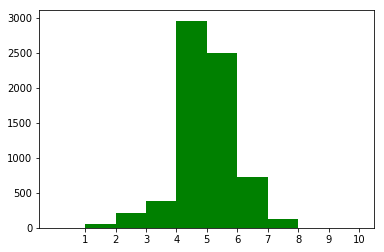

In [57]:
nameHere=input("input a name. for a list of names, type 'help'.")
if nameHere=='help':
    for name in finalDict.keys():
        print(name) 
else:
    pos = np.arange(len(finalDict[nameHere][1]))
    width = 1.0 # gives histogram aspect to the bar diagram
    ax = plt.axes()
    ax.set_xticks(pos + (width / 2))
    ax.set_xticklabels(finalDict[nameHere][1].keys())
    print(finalDict[nameHere][1].values())
    plt.bar(finalDict[nameHere][1].keys(), finalDict[nameHere][1].values(), width, color='g')
    plt.show()

input a name. for a list of names, type 'help'.ned


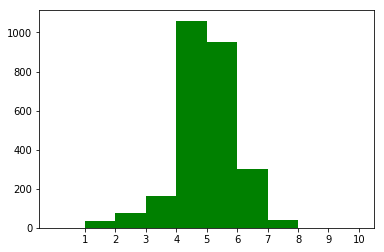

In [58]:
nameHere=input("input a name. for a list of names, type 'help'.")
if nameHere=='help':
    for name in finalDict.keys():
        print(name) 
else:
    pos = np.arange(len(finalDict[nameHere][1]))
    width = 1.0 # gives histogram aspect to the bar diagram
    ax = plt.axes()
    ax.set_xticks(pos + (width / 2))
    ax.set_xticklabels(finalDict[nameHere][1].keys())

    plt.bar(finalDict[nameHere][1].keys(), finalDict[nameHere][1].values(), width, color='g')
    plt.show()